# Example 6 -- Voronoi Flow and Transport

In [1]:
import pathlib as pl
import matplotlib.pyplot as plt
import matplotlib.animation
import numpy as np
from shapely.geometry import Polygon, LineString, Point
import flopy
import flopy.utils.triangle
import flopy.utils.voronoi
import geopandas as gp

## Create and Run the Flow Model

writing simulation...
  writing simulation name file...
  writing simulation tdis package...
  writing solution package ims_-1...
  writing model mymodel...
    writing model name file...
    writing package disv...
    writing package ic...
    writing package npf...
    writing package chd_0...
INFORMATION: maxbound in ('gwf6', 'chd', 'dimensions') changed to 167 based on size of stress_period_data
    writing package rcha_0...
    writing package oc...
FloPy is using the following executable to run the model: ..\..\..\..\..\AppData\Local\mambaforge\envs\flopyswf\Scripts\mf6.exe
                                   MODFLOW 6
                U.S. GEOLOGICAL SURVEY MODULAR HYDROLOGIC MODEL
                            VERSION 6.4.4 02/13/2024

   MODFLOW 6 compiled Feb 19 2024 14:20:00 with Intel(R) Fortran Intel(R) 64
   Compiler Classic for applications running on Intel(R) 64, Version 2021.7.0
                             Build 20220726_000000

This software has been approved for releas

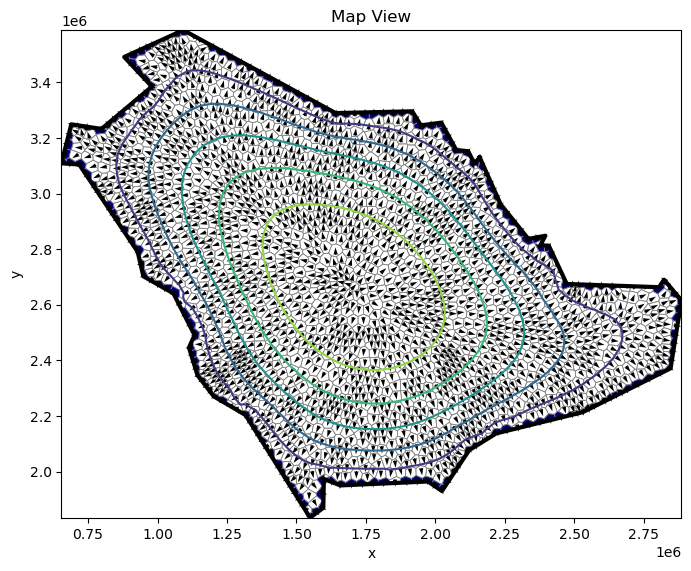

In [2]:
ws = './ex6'
name = 'mymodel'
tempdir = pl.Path(ws, "temp")
tempdir.mkdir(parents=True, exist_ok=True)

domaingdf = gp.read_file('./data/ksa_outline.json').to_crs(8836)
bounds = domaingdf.bounds
domain =domaingdf.geometry.values[0]
# Create a voronoi grid
area_max = 30000.0**2
tri = flopy.utils.triangle.Triangle(maximum_area=area_max, angle=34, model_ws=ws)
tri.add_polygon(domain)
tri.build(verbose=False)
vor = flopy.utils.voronoi.VoronoiGrid(tri)
vg_gridprops = vor.get_gridprops_vertexgrid()
vg = flopy.discretization.VertexGrid(**vg_gridprops)

top = 50.
botm = [-5000.]
nlay = 1

# create and run steady-state flow simulation
ws_flow = pl.Path(ws, "flow")
sim = flopy.mf6.MFSimulation(sim_name=name, sim_ws=ws_flow, exe_name='mf6')
tdis = flopy.mf6.ModflowTdis(sim)
ims = flopy.mf6.ModflowIms(sim, print_option="all", inner_maximum=100)
gwf = flopy.mf6.ModflowGwf(sim, modelname=name, save_flows=True)
disv = flopy.mf6.ModflowGwfdisv(
    gwf, nlay=nlay, **vor.get_disv_gridprops(), top=top, botm=botm)
ic = flopy.mf6.ModflowGwfic(gwf, strt=top)
npf = flopy.mf6.ModflowGwfnpf(
    gwf, save_specific_discharge=True, save_saturation=True, icelltype=1,
)

gi = flopy.utils.GridIntersect(gwf.modelgrid)
ls = LineString([p for p in domain.exterior.coords])
chdspd = [[(0, j), 1.] for j in np.array(gi.intersects(ls)["cellids"], dtype=int)]
chd = flopy.mf6.ModflowGwfchd(gwf, stress_period_data=chdspd)
rch = flopy.mf6.ModflowGwfrcha(gwf, recharge=0.0001)
oc = flopy.mf6.ModflowGwfoc(gwf,
                            budget_filerecord=f"{name}.bud",
                            head_filerecord=f"{name}.hds",
                            printrecord=[('HEAD', 'ALL'), ('BUDGET', 'ALL')],
                            saverecord=[('HEAD', 'ALL'), ('BUDGET', 'ALL')])
sim.write_simulation()
sim.run_simulation()

head = gwf.output.head().get_data()
bud = gwf.output.budget()
spdis = bud.get_data(text='DATA-SPDIS')[0]
qx, qy, qz = flopy.utils.postprocessing.get_specific_discharge(spdis, gwf)

fig, axes = plt.subplots(1, 1, figsize=(8, 11))
ax = axes
ax.set_title("Map View")
ax.set_aspect(1)
ax.set_xlabel("x")
ax.set_ylabel("y")
pmv = flopy.plot.PlotMapView(gwf, ax=ax)
pmv.plot_bc(ftype="CHD")
pmv.plot_grid(linewidth=0.5)
#pmv.plot_array(head)
pmv.plot_vector(qx, qy, normalize=True, color="black", istep=1, jstep=1)
pmv.contour_array(head)
ax.plot(*domain.exterior.xy, color="black", linewidth=3.)



## Create and Run the Transport Model

writing simulation...
  writing simulation name file...
  writing simulation tdis package...
  writing solution package ims_-1...
  writing model mymodel...
    writing model name file...
    writing package disv...
    writing package ic...
    writing package mst...
    writing package adv...
    writing package dsp...
    writing package ssm...
    writing package fmi...
    writing package cnc_0...
INFORMATION: maxbound in ('gwt6', 'cnc', 'dimensions') changed to 1 based on size of stress_period_data
    writing package oc...


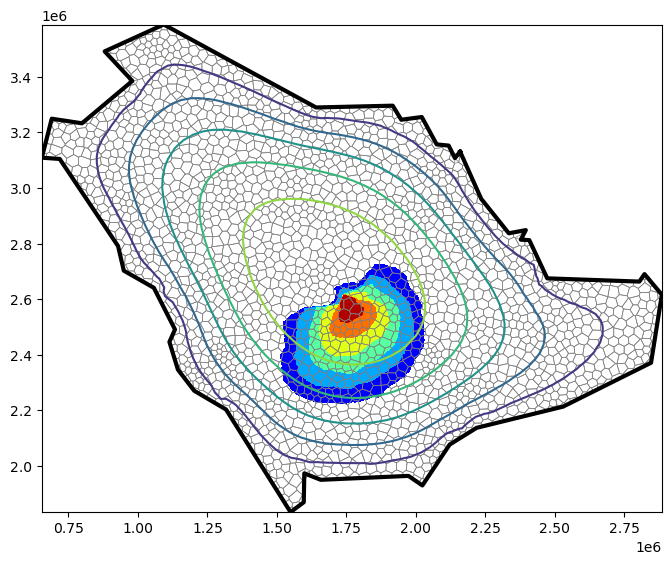

In [3]:
# create and run transient transport simulation using flow results
ws_transport = pl.Path(ws, "transport")
sim = flopy.mf6.MFSimulation(sim_name=name, sim_ws=ws_transport, exe_name='mf6')
tdis = flopy.mf6.ModflowTdis(sim, nper=1, perioddata=[(3650000., 100, 1.0)])
ims = flopy.mf6.ModflowIms(sim, print_option="all", linear_acceleration="BICGSTAB", inner_maximum=100)
gwt = flopy.mf6.ModflowGwt(sim, modelname=name, save_flows=True)
disv = flopy.mf6.ModflowGwtdisv(
    gwt, nlay=nlay, **vor.get_disv_gridprops(), top=top, botm=botm)
ic = flopy.mf6.ModflowGwtic(gwt, strt=0.)
mst = flopy.mf6.ModflowGwtmst(gwt, porosity=0.12)
adv = flopy.mf6.ModflowGwtadv(gwt, scheme="upstream")
dsp = flopy.mf6.ModflowGwtdsp(gwt, alh=10., ath1=1.)
sourcerecarray = [()]
ssm = flopy.mf6.ModflowGwtssm(gwt, sources=sourcerecarray)
pd = [
    ("GWFHEAD", f"../flow/{name}.hds"),
    ("GWFBUDGET", f"../flow/{name}.bud"),
]
fmi = flopy.mf6.ModflowGwtfmi(gwt, packagedata=pd)
gi = flopy.utils.GridIntersect(gwt.modelgrid)
ix = gi.intersect(Point(1.75e6,2.6e6))
cnc_node = ix["cellids"][0]
cnc = flopy.mf6.ModflowGwtcnc(gwt, stress_period_data=[((0, cnc_node), 1000.),])
oc = flopy.mf6.ModflowGwtoc(
    gwt,
    budget_filerecord=f"{name}.cbc",
    concentration_filerecord=f"{name}.ucn",
    saverecord=[("CONCENTRATION", "ALL"), ("BUDGET", "LAST")],
    printrecord=[("CONCENTRATION", "LAST"), ("BUDGET", "LAST")],
)
sim.write_simulation()
sim.run_simulation(silent=True)

cobj = gwt.output.concentration()
conc = cobj.get_data()
conc_alldata = cobj.get_alldata()
times = cobj.times
budgwt = gwt.output.budget()

levels = [0.001, 0.01, 0.1, 1., 10., 100., 1000]
cmap = plt.colormaps["jet"].with_extremes(under="white", over="white")
ca_dict = {
    "cmap": cmap, 
    "extend": "both", 
    "levels":levels, 
    "filled":True,
    "norm": "log",
}

fig, ax = plt.subplots(figsize=(8, 8))
ax.set_aspect(1)
pmv = flopy.plot.PlotMapView(gwt, ax=ax)
pmv.plot_grid(linewidth=0.5)
pmv.contour_array(head)
pmv.contour_array(conc, **ca_dict)
ax.plot(*domain.exterior.xy, color="black", linewidth=3.)

## Post-Process the Results into an Animation

In [4]:
fig, ax = plt.subplots(figsize=(8, 6))
ax.set_aspect(1)
ax.set_xlabel(r'x')
ax.set_ylabel(r'y')
title = ax.set_title(f"Time = {times[0]} days")

# plot persistent items
pmv = flopy.plot.PlotMapView(gwt, ax=ax)
pmv.plot_grid(linewidth=0.1)
pmv.contour_array(head)
levels = [0.001, 0.01, 0.1, 1., 10., 100., 1000.]
cmap = plt.colormaps["jet"].with_extremes(under="white", over="white")
ca_dict = {
    "cmap": cmap, 
    "extend": "both", 
    "levels":levels, 
    "filled":True,
    "norm": "log",
}
cont = pmv.contour_array(conc_alldata[0], **ca_dict)
fig.colorbar(cont, shrink=0.5)
ax.plot(*domain.exterior.xy, color="black", linewidth=3.)

def animate(i):
    global cont
    global title
    for coll in ax.collections[:]:
        if isinstance(coll, matplotlib.tri.TriContourSet):
            coll.remove()
    cont = pmv.contour_array(conc_alldata[i], **ca_dict)
    title = ax.set_title(f"Time = {times[i]} days")
    return cont

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=conc_alldata.shape[0])
plt.close()

from IPython.display import HTML
HTML(ani.to_jshtml())

# can use this command to write animation to file
#ani.save("ex6-animation.avi")